### 統計學習與深度學習
### Homework 3
#### 姓名：黃瀚陞  學號：R09725060


請將IPYNB檔與IPYNB Export之HTML檔上傳至COOL作業區。回答作業時建議使用 "三明治" 答題法。也就是說，先說明要做什麼，然後列出程式碼與結果，最後說明這些結果的意義。作業自己做。嚴禁抄襲。不接受紙本繳交，不接受遲交。請以英文或中文作答。


### 第一題 [分類器、特徵建構、與Stacking]

(50%) 建構分類器時常會透過特徵選擇與Ensemble增強預測能力。本題的目的是讓大家練習這些技巧。本題使用一個中文姓名分類的資料集。這個資料集收集了10730個中文名(不含姓)，以及這些名子對應到的性別。本資料集的資料檔是**namesex_data_v2.csv**，共有三個欄位，gname, sex, fold:
* gname: 不含姓的中文名。
* sex: 1為男性，0為女性。
* fold: 為0 - 9的整數，做為後續切割資料集使用。

我們先將這個資料集讀入Numpy Array，並列印前十筆資料。

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import csv
import numpy as np
import warnings
warnings.filterwarnings("ignore")

f = open('ds/namesex_data_v2.csv', 'r', encoding='utf8')
mydata = csv.DictReader(f)
sexlist = []
namelist = []
foldlist = []
for i, arow in enumerate(mydata):
    if i < 10:
        print(arow)
    sexlist.append(int(arow['sex'].strip()))
    gname = arow['gname'].strip()
    namelist.append(gname)
    foldlist.append(int(arow['fold'].strip()))

sexlist = np.asarray(sexlist)
namelist = np.asarray(namelist)
foldlist = np.asarray(foldlist)
f.close()

OrderedDict([('gname', '承憲'), ('sex', '1'), ('fold', '9')])
OrderedDict([('gname', '均平'), ('sex', '1'), ('fold', '7')])
OrderedDict([('gname', '思安'), ('sex', '0'), ('fold', '6')])
OrderedDict([('gname', '佑誠'), ('sex', '1'), ('fold', '3')])
OrderedDict([('gname', '乃馨'), ('sex', '0'), ('fold', '0')])
OrderedDict([('gname', '婕'), ('sex', '0'), ('fold', '0')])
OrderedDict([('gname', '冠瑜'), ('sex', '0'), ('fold', '1')])
OrderedDict([('gname', '冠學'), ('sex', '1'), ('fold', '0')])
OrderedDict([('gname', '立翰'), ('sex', '1'), ('fold', '2')])
OrderedDict([('gname', '以柔'), ('sex', '0'), ('fold', '6')])


接下來看一些統計數字:

In [2]:
nobs = namelist.shape[0]
print("資料筆數 = ", nobs)

資料筆數 =  10730


In [3]:
avg_sex = np.mean(sexlist)
print("男性比率", avg_sex)

男性比率 0.47940354147250697


這個資料集的男女比率還算是平均，男性佔了47.94%。

我們用了比較迂迴的方式讀檔案，Pandas其實可以直接讀csv檔。接下來做一些基本的資料分析。我們關心幾件事:
* 最常見的名子
* 共有多少個不重複的名子
* 有多少難判斷男女的名子

要回答這些問題，首先對名子加總，計算數量與男性比率，排序之後列出前20個名子:

In [4]:
import pandas as pd
name_df = pd.DataFrame({'sex': sexlist, 'name': namelist, 'fold': foldlist})
sex_tend = name_df[['name', 'sex']].groupby(["name"]).agg(['mean', 'count']).reset_index()
sex_tend.columns = ['-'.join(col).strip() for col in sex_tend.columns.values]
sex_tend = sex_tend.sort_values(['sex-count'], ascending=False)

print("最常見的20個名子:")
sex_tend.head(20)

最常見的20個名子:


,name-,sex-mean,sex-count
3738,承恩,1.000000,20
918,冠廷,1.000000,20
2506,宜蓁,0.000000,18
545,佳穎,0.000000,16
3196,彥廷,0.923077,13
913,冠宇,1.000000,13
3390,思妤,0.000000,13
1019,凱翔,1.000000,13
3769,承翰,1.000000,13
3477,怡萱,0.000000,13


由上面的列表看來，最常見的男性名子是承恩與冠廷，最常見的女性名子是宜蓁與佳穎。而這些常見的名子男性比率都非常接近0或1，表示這些名子沒有性別混淆的問題。

另外一個問題是有多少名子只出現一次:

In [5]:
single_name = np.sum(sex_tend['sex-count'] <= 1)
print("出現一次名子個數: ", single_name, "比率:", single_name / nobs)

出現一次名子個數:  7067 比率: 0.6586206896551724


由結果看來，名子在資料集中只出現一次的比率很高，有65%。也就是說，如果單純的使用訓練資料中出現的名子做為特徵，模型應該會有很差的預測能力。

#### <font color=#800000>為了處理這個問題，我們在接下來的任務中，會使用"Unigram + Full Name"的特徵表示，比如說，"芳瑜"的特徵表示為"芳"、"瑜"，以及原始的名子"芳瑜"。</font>

最後我們來看看性別混淆的名子:

In [6]:
ind1 = (sex_tend['sex-mean'] > 0.4) & (sex_tend['sex-mean'] < 0.6)
sex_amb = sex_tend[ind1]
amb_count = sex_amb['sex-count'].sum()
print("難區分性別姓名數量: ", amb_count, "比率:", amb_count/ nobs)

難區分性別姓名數量:  136 比率: 0.012674743709226468


難以區分性別的名子總數並不高，所占總體資料的比率也很低，只有1.26%，因此不用擔心這個因素會影響預測準確率。

下面來看看幾個容易混淆性別的名子:

In [7]:
sex_amb.head()

,name-,sex-mean,sex-count
6777,育瑋,0.5,4
338,以恩,0.5,4
7783,郁軒,0.5,4
2513,宜謙,0.5,4
5920,祐嘉,0.5,4


#### 實做限制
為了確保可以確實練習到重要技巧，禁用Pycaret (<https://pycaret.org/>) 這類可以自動化調教參數與Ensemble模型的工具。另外也禁止使用`sklearn.ensemble.Stacking.*`。你可以使用sklearn中Pre-processing工具函數與現成的分類器，但參數調教請自行處理。



#### 回答下面問題
#### Q1.1 (10%): 
使用One-hot Encoding建構資料變數。所有資料變數都要是Numpy Array。依照每筆資料其fold值切割為Training (fold <=6)、Validation (fold == 7)、Stacking (fold == 8)、Test (fold == 9)。每個資料集應有特徵Array(二維)以及Label Array(一維)。如前面提到的，每個名子應該要對應到全名以及單字的One-hot Encoding。比如說，"芳瑜"的特徵表示為"芳"、"瑜"，以及原始的名子"芳瑜"。建構特徵表示時應依照個特徵出現的頻率篩選。特徵在訓練資料出現兩次或以上才納入。如果一個特徵被排除，這個特徵出現時應被歸為"\_Other_Feature_"。任何名子只要有出現未被納入的特徵，則其"\_Other_Feature_"的欄位值為1。

舉例而言，假設訓練資料集中有下面三個名子: 承恩、承德、恩賜。在經過特徵頻率篩選之後，只剩下以下特徵: 承、恩。其他特徵，如承恩、承德、恩賜、德、賜皆被排除。因此最後的特徵表示為:

Input | 承 | 恩 | \_Other_Feature_ |
------|----|----|-----------------|
承恩  | 1  | 1   |  1    |
承德  | 1  | 0   |  1  |
恩賜  | 0  | 1   |  1 |

最後應產生以下Numpy Array:
* x_train: Training Features
* y_train: Training Labels
* x_valid: Validation Features
* y_valid: Validation Labels
* x_stack: Stack Features
* y_stack: Stack Labels
* x_test: Test Features
* y_test: Test Labels

請列出每個Numpy Array的Shape以資查驗。

In [8]:
nameintraining_df=name_df[name_df['fold']<=6]["name"]
nameintraining_df=nameintraining_df.reset_index(drop=True)
#nameintraining_df

In [9]:
word_dictionary_uni=""

# onlyname_df=name_testing
# onlyname_df=name_df["name"]
onlyname_df=nameintraining_df

for i in range(len(onlyname_df)):
    for j in range(len(onlyname_df[i])):
        compare_str=onlyname_df[i][j]
        if compare_str not in word_dictionary_uni:
            word_dictionary_uni=word_dictionary_uni+compare_str
            
word_dictionary_uni_list=[]
for i in range(len(word_dictionary_uni)):
    word_dictionary_uni_list.append(word_dictionary_uni[i])

#print(word_dictionary_uni_list)

In [10]:
count=0
rareword_list_index=[]

for p in range(len(word_dictionary_uni_list)):
    for q in range(len(onlyname_df)):
        for r in range(len(onlyname_df[q])):
            if word_dictionary_uni_list[p]==onlyname_df[q][r]:
                count=count+1
        if count>1:
            count=0
            break;
    if count==1:
        rareword_list_index.append(p)
        count=0

#rareword_list_index

In [11]:
rareword_list=[]
for i in range(len(rareword_list_index)):
    rareword_list.append(word_dictionary_uni_list[rareword_list_index[i]])
    
for i in range(len(rareword_list)):
    word_dictionary_uni_list.remove(rareword_list[i])

unit_item=word_dictionary_uni_list
#unit_item

In [12]:
word_dictionary_uni_count_list=[]
count=0

for p in range(len(word_dictionary_uni_list)):
    for q in range(len(onlyname_df)):
        for r in range(len(onlyname_df[q])):
            if word_dictionary_uni_list[p]==onlyname_df[q][r]:
                count=count+1
    word_dictionary_uni_count_list.append(count)
    count=0

#print(len(word_dictionary_uni_count_list))
#word_dictionary_uni_count_list


In [13]:
name_onlytrain_df=name_df[name_df['fold']<=6]
sex_tend = name_onlytrain_df[['name', 'sex']].groupby(["name"]).agg(['mean', 'count']).reset_index()
sex_tend.columns = ['-'.join(col).strip() for col in sex_tend.columns.values]
sex_tend = sex_tend.sort_values(['sex-count'], ascending=False)

fullname_item=sex_tend[sex_tend['sex-count']>1]['name-']
fullname_item=fullname_item.tolist()
#print(len(fullname_item))
#fullname_item

In [14]:
clean_data_df=name_df
clean_data_df=pd.DataFrame(clean_data_df, columns=['name','fold','sex'])
clean_data_df=clean_data_df.rename({'name':'Input'}, axis='columns')

for i in range(len(unit_item)):
    clean_data_df[unit_item[i]]=0
    
for i in range(len(fullname_item)):
    clean_data_df[fullname_item[i]]=0

clean_data_df['_Other_Feature_']=0
clean_data_df


,Input,fold,sex,思,安,佑,誠,乃,馨,婕,...,孟樺,昀臻,秉翰,采蓉,岱融,祈緯,芷羚,郁棋,晉揚,_Other_Feature_
0,承憲,9,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,均平,7,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,思安,6,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,佑誠,3,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,乃馨,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10725,嘉銘,3,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10726,佳芸,8,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10727,又華,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10728,子晉,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [15]:
for i in range(len(clean_data_df)): #len(clean_data_df)
    full_name=clean_data_df['Input'][i]
    if(len(full_name)==1):
        if full_name in clean_data_df.columns:
            clean_data_df[full_name][i]=1
        else:
            clean_data_df['_Other_Feature_'][i]=1
    else:
        first=full_name[0]
        second=full_name[1]
        if full_name in clean_data_df.columns:
            clean_data_df[full_name][i]=1
        else:
            clean_data_df['_Other_Feature_'][i]=1
        if first in clean_data_df.columns:
            clean_data_df[first][i]=1
        else:
            clean_data_df['_Other_Feature_'][i]=1
        if second in clean_data_df.columns:
            clean_data_df[second][i]=1
        else:
            clean_data_df['_Other_Feature_'][i]=1

clean_data_df

,Input,fold,sex,思,安,佑,誠,乃,馨,婕,...,孟樺,昀臻,秉翰,采蓉,岱融,祈緯,芷羚,郁棋,晉揚,_Other_Feature_
0,承憲,9,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,均平,7,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,思安,6,0,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,佑誠,3,1,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
4,乃馨,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10725,嘉銘,3,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
10726,佳芸,8,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10727,又華,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
10728,子晉,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [16]:
feature_name=clean_data_df.columns
feature_name=feature_name.delete([0,1,2])
feature_name

Index(['思', '安', '佑', '誠', '乃', '馨', '婕', '冠', '瑜', '學',
       ...
       '孟樺', '昀臻', '秉翰', '采蓉', '岱融', '祈緯', '芷羚', '郁棋', '晉揚',
       '_Other_Feature_'],
      dtype='object', length=1630)

In [17]:
x_train=clean_data_df[clean_data_df['fold']<=6].drop(columns=['Input','fold','sex']).to_numpy()
y_train=clean_data_df[clean_data_df['fold']<=6]['sex'].to_numpy()
print("x_train shape:",x_train.shape,"; y_train shape:",y_train.shape)

x_valid=clean_data_df[clean_data_df['fold']==7].drop(columns=['Input','fold','sex']).to_numpy()
y_valid=clean_data_df[clean_data_df['fold']==7]['sex'].to_numpy()
print("x_valid shape:",x_valid.shape,"; y_valid shape:",y_valid.shape)

x_stack=clean_data_df[clean_data_df['fold']==8].drop(columns=['Input','fold','sex']).to_numpy()
y_stack=clean_data_df[clean_data_df['fold']==8]['sex'].to_numpy()
print("x_stack shape:",x_stack.shape,"; y_stack shape:",y_stack.shape)

x_test=clean_data_df[clean_data_df['fold']==9].drop(columns=['Input','fold','sex']).to_numpy()
y_test=clean_data_df[clean_data_df['fold']==9]['sex'].to_numpy()
print("x_test shape:",x_test.shape,"; y_test shape:",y_test.shape)

x_train shape: (7483, 1630) ; y_train shape: (7483,)
x_valid shape: (1110, 1630) ; y_valid shape: (1110,)
x_stack shape: (1073, 1630) ; y_stack shape: (1073,)
x_test shape: (1064, 1630) ; y_test shape: (1064,)


1.1 解釋：  
共有1630個feature，shape如上程式輸出所示。

#### Q1.2 (10%):
使用`sklearn.linear_model.LogisticRegression()`建構Logistic Regression分類模型。利用Training與Validation調教Regularization Coefficient $c$。Grid Search的小值為$10^{-4}$，最大值是$1,000$，總共取20個點，使用等比級數間隔。取F-1 Score最大之Regularization Coefficient，印出此數值(以下稱bestc)。將Training與Validation合併後，令Regularizaiton Coefficient為bestc，訓練最終模型，並報告Test Data的Accuracy, Precision, Recall, 與F-1 Score。另外列出係數絕對值最大的20個特徵。注意應列出未取絕對值的係數數值，方知特徵的性別傾向。討論Prediction Performance與重要特徵的合理性。


In [18]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

ratio=pow(1000/0.0001,1.0/19)
grids=[]
current=0.0001
grids.append(current)
for i in range(1,20):
    current=current*ratio
    grids.append(current)
    
bestf1=0
bestc=grids[0]
for i in range(len(grids)):
    lrg=LogisticRegression(solver='liblinear',C=grids[i])
    lrg.fit(x_train,y_train)
    ypred=lrg.predict(x_valid)
    f1=f1_score(y_valid,ypred)
    print("C:",grids[i],"; F1:",f1)
    if(f1>bestf1):
        bestf1=f1
        bestc=grids[i]

print("Best F1 Score:",bestf1,"; Best C:",bestc)

C: 0.0001 ; F1: 0.018726591760299623
C: 0.00023357214690901222 ; F1: 0.1340388007054674
C: 0.0005455594781168519 ; F1: 0.39398496240601505
C: 0.0012742749857031339 ; F1: 0.6784869976359338
C: 0.0029763514416313182 ; F1: 0.8114754098360656
C: 0.0069519279617756054 ; F1: 0.8516746411483254
C: 0.016237767391887217 ; F1: 0.8711194731890874
C: 0.037926901907322494 ; F1: 0.876763875823142
C: 0.08858667904100825 ; F1: 0.8867924528301888
C: 0.20691380811147894 ; F1: 0.888468809073724
C: 0.48329302385717526 ; F1: 0.8932955618508026
C: 1.1288378916846888 ; F1: 0.8945386064030133
C: 2.6366508987303576 ; F1: 0.8953817153628653
C: 6.158482110660262 ; F1: 0.8930936613055818
C: 14.384498882876622 ; F1: 0.8972667295004714
C: 33.59818286283781 ; F1: 0.8962264150943396
C: 78.4759970351461 ; F1: 0.8981132075471698
C: 183.2980710832435 ; F1: 0.8962264150943396
C: 428.13323987193917 ; F1: 0.8960302457466919
C: 999.9999999999994 ; F1: 0.8968779564806055
Best F1 Score: 0.8981132075471698 ; Best C: 78.4759970

In [19]:
big_x_train=np.concatenate((x_train,x_valid),axis=0)
big_y_train=np.concatenate((y_train,y_valid),axis=0)

lrg=LogisticRegression(solver='liblinear',C=bestc)
lrg.fit(big_x_train,big_y_train)
ypred=lrg.predict(x_test)

accuracy=accuracy_score(y_test,ypred)
precision=precision_score(y_test,ypred)
recall=recall_score(y_test,ypred)
f1=f1_score(y_test,ypred)

print("C:",bestc,"\nAccuracy:",accuracy,"\nPrecision:",precision,"\nRecall:",recall,"\nF1:",f1)

C: 78.4759970351461 
Accuracy: 0.8843984962406015 
Precision: 0.8596837944664032 
Recall: 0.893223819301848 
F1: 0.8761329305135951


In [20]:
coef=lrg.coef_[0]
coef_abs=np.absolute(coef)
sort_coef_index=np.argsort(-coef_abs)
top20_coef_index=sort_coef_index[0:20]

for i in range(len(top20_coef_index)):
    print("Word:",feature_name[top20_coef_index[i]],coef[top20_coef_index[i]])

Word: 傑 9.272387730023487
Word: 森 8.70434048492334
Word: 玲 -8.639628318798263
Word: 雯 -8.483992161880796
Word: 凌 -8.452012725389146
Word: 婷 -8.368102722841043
Word: 美 -8.31438615159734
Word: 萱 -8.297569292122509
Word: 鋒 8.219408565176975
Word: 薇 -8.219040205421527
Word: 婕 -8.145972846358783
Word: 綾 -8.144425340231782
Word: 妤 -8.129941572344096
Word: 潔 -8.030579388442648
Word: 嵐 -7.885220727079101
Word: 絃 -7.849416098645802
Word: 卉 -7.8144497454603306
Word: 靜 -7.658813367278256
Word: 松 7.618471136414972
Word: 蓉 -7.592674669589487


1.2 解釋：  
表現最好的C為78.4759970351461，最終模型的表現上，F1約為0.87613，其餘指標如上輸出所示。係數特徵的部分，絕對值最大的是「傑」，第二是「森」，其餘可見於上輸出。  
performance的表現上，可見應該還是有一成多一點的人的姓名沒有辦法被正確預測。但從重要特徵來看，大部分確實與我平常藉由名字判斷性別的印象差不多，例如看到「傑」，很容易就會覺得這是男生的名字（在特徵的係數上也是正數，代表此性別傾向男生），又或者是像「玲」，也會覺得是女生的名字（在特徵的係數上也是負數，代表此性別傾向女生）。

#### Q1.3 (10%):
使用`sklearn.ensemble.RandomForestClassifier()`建構Random Forest分類模型。利用Training與Validation調教Number of Tress (i.e., n_estimators)。Grid Search的小值為$5$，最大值是$1,000$，總共取10個點，使用等比級數間隔。取F-1 Score最大之n_estimators，印出此數值(best_nest)。將Training與Validation合併後，令n_estimators為best_nest，訓練最終模型，並報告Test Data的Accuracy, Precision, Recall, 與F-1 Score。另外列出最重要的20個特徵。討論Prediction Performance與重要特徵的合理性。

In [21]:
from sklearn.ensemble import RandomForestClassifier

ratio=pow(1000/5,1.0/9)
grids=[]
current=5
grids.append(current)
for i in range(1,10):
    current=current*ratio
    grids.append(round(current))
        
    
bestf1=0
best_nest=grids[0]
for i in range(len(grids)):
    rf=RandomForestClassifier(max_depth=grids[i],random_state=543)
    rf.fit(x_train,y_train)
    ypred=rf.predict(x_valid)
    f1=f1_score(y_valid,ypred)
    print("N_est:",grids[i],"; F1:",f1)
    if(f1>bestf1):
        bestf1=f1
        best_nest=grids[i]

print("Best F1 Score:",bestf1,"; Best nest :",best_nest)

N_est: 5 ; F1: 0.5595716198125837
N_est: 9 ; F1: 0.6824644549763033
N_est: 16 ; F1: 0.7672131147540984
N_est: 29 ; F1: 0.8314410480349346
N_est: 53 ; F1: 0.830155979202773
N_est: 95 ; F1: 0.8333333333333334
N_est: 171 ; F1: 0.8656987295825772
N_est: 308 ; F1: 0.8766114180478822
N_est: 555 ; F1: 0.8677450047573739
N_est: 1000 ; F1: 0.8660968660968661
Best F1 Score: 0.8766114180478822 ; Best nest : 308


In [22]:
rf=RandomForestClassifier(max_depth=best_nest,random_state=87)
rf.fit(big_x_train,big_y_train)
ypred=rf.predict(x_test)

accuracy=accuracy_score(y_test,ypred)
precision=precision_score(y_test,ypred)
recall=recall_score(y_test,ypred)
f1=f1_score(y_test,ypred)

print("Best nest:",best_nest,"\nAccuracy:",accuracy,"\nPrecision:",precision,"\nRecall:",recall,"\nF1:",f1)

Best nest: 308 
Accuracy: 0.849624060150376 
Precision: 0.8067542213883677 
Recall: 0.8829568788501027 
F1: 0.8431372549019608


In [23]:
importance=rf.feature_importances_

sort_coef_index=np.argsort(-importance)
top20_coef_index=sort_coef_index[0:20]

for i in range(len(top20_coef_index)):
    print("Word:",feature_name[top20_coef_index[i]],importance[top20_coef_index[i]])

Word: 妤 0.019846130248939452
Word: 翔 0.0164527151045296
Word: 萱 0.014634336959936633
Word: 柏 0.014345040849755174
Word: 婷 0.013468548642252935
Word: 怡 0.010010779796594644
Word: 蓁 0.009625997584781455
Word: 承 0.009082018569197155
Word: 雅 0.009065482684222985
Word: 佳 0.009052068555684264
Word: 哲 0.008919185473332378
Word: 芸 0.008690394272359146
Word: 柔 0.008609987607774022
Word: 晴 0.008584859481159458
Word: 芷 0.008486329797739358
Word: 庭 0.008463481519386978
Word: 瑄 0.008169764804876684
Word: 宜 0.008137698173556356
Word: 涵 0.00798309978983573
Word: 婕 0.007744580353838968


1.3 解釋：  
表現最好的n_estimators為308，最終模型的表現上，F1約為0.8431，其餘指標如上輸出所示。係數絕對值特徵的部分，絕對值最大的是「妤」，第二是「翔」，其餘可見於上輸出。  
performance的表現上，random forest的分類表現比logistic regression來得差，約有一成五的名字沒辦法被正確分類。從重要特徵來看，也大部分與我平常藉由名字判斷性別的印象差不多，但random forest列出的特徵沒有辦法藉由正負來看出是男生還是女生的傾向，但因為都是比較重要的特徵，所以也可以大致猜出性別。

#### Q1.4 (10%):
使用`sklearn.ensemble.GradientBoostingClassifier()`建構Gradient Boosting Decision Tree (GBDT)分類模型。利用Training與Validation調教learning_rate與n_estimators。考慮以下Learning Rate: 0.1, 0.5, 1。每一個Learning Rate設n_estimator為1,500並估計一個GBDT分類器，計算1,500個Stages下Validation F-1 Score值，繪圖，並找出讓F-1 Score最大的Stage與F-1 Score最大值。對所有Learning Rate重複同樣程序，找出最佳的Learning Rate (稱best_lr) 與其對應的Number of Stages(best_nstg)。將Training與Validation合併後，令learning_rate為best_lr, n_estimators為best_nstg，訓練最終模型，並報告Test Data的Accuracy, Precision, Recall, 與F-1 Score。另外列出最重要的20個特徵。討論Prediction Performance與重要特徵的合理性。

Learning Rate: 0.1


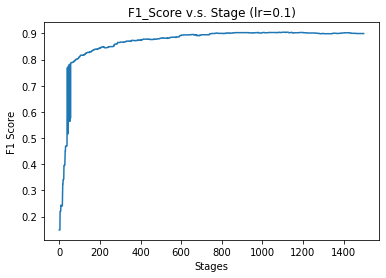

Learning Rate: 0.5


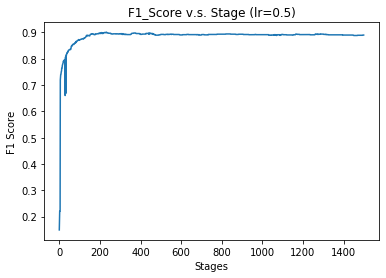

Learning Rate: 1


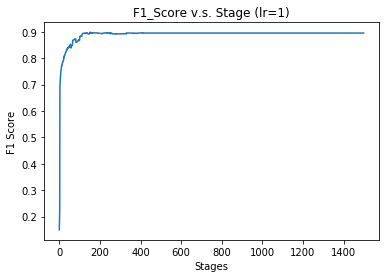

In [24]:
from sklearn.ensemble import GradientBoostingClassifier
import matplotlib.pyplot as plt
%matplotlib inline

lr_grids=[0.1, 0.5, 1]
best_stage_list=[]
best_f1_list=[]

for i in range(len(lr_grids)):
    print("Learning Rate:",lr_grids[i])
    GBDT=GradientBoostingClassifier(n_estimators=1500,learning_rate=lr_grids[i])
    GBDT.fit(x_train,y_train)
    
    beststage=0
    bestf1=0
    f1_score_list=[]
    iteration=0
    
    for ypred in GBDT.staged_predict(x_valid):
        f1=f1_score(y_valid,ypred)
#         print(f1)
        f1_score_list.append(f1)
        if f1>bestf1:
            bestf1=f1
            beststage=iteration
            
        iteration=iteration+1
    
    best_stage_list.append(beststage)
    best_f1_list.append(bestf1)
    
    plt.plot(f1_score_list)
    plt.xlabel('Stages')
    plt.ylabel('F1 Score')
    title='F1_Score v.s. Stage (lr='+str(lr_grids[i])+')'
    plt.title(title)
    plt.show()

In [25]:
print(best_stage_list)
print(best_f1_list)

max_f1_value=max(best_f1_list)
max_lr_index=best_f1_list.index(max_f1_value)

best_lr=lr_grids[max_lr_index]
best_nstg=best_stage_list[max_lr_index]
print("Best Learning Rate:",best_lr)
print("Best Number of Stages:",best_nstg)

[1083, 230, 153]
[0.904186046511628, 0.9008341056533828, 0.8984156570363467]
Best Learning Rate: 0.1
Best Number of Stages: 1083


In [26]:
GBDT=GradientBoostingClassifier(n_estimators=best_nstg,learning_rate=best_lr)
GBDT.fit(big_x_train,big_y_train)
ypred=GBDT.predict(x_test)

accuracy=accuracy_score(y_test,ypred)
precision=precision_score(y_test,ypred)
recall=recall_score(y_test,ypred)
f1=f1_score(y_test,ypred)

print("Best lr:",best_lr,"Best nstg:",best_nstg,"\nAccuracy:",accuracy,"\nPrecision:",precision,"\nRecall:",recall,"\nF1:",f1)

Best lr: 0.1 Best nstg: 1083 
Accuracy: 0.8703007518796992 
Precision: 0.8286252354048964 
Recall: 0.9034907597535934 
F1: 0.8644400785854617


In [27]:
importance=GBDT.feature_importances_

sort_coef_index=np.argsort(-importance)
top20_coef_index=sort_coef_index[0:20]

for i in range(len(top20_coef_index)):
    print("Word:",feature_name[top20_coef_index[i]],importance[top20_coef_index[i]])

Word: 妤 0.029489992932023812
Word: 翔 0.02266366836718137
Word: 萱 0.020041917246178747
Word: 柏 0.019581971458022224
Word: 婷 0.018865307428831007
Word: 承 0.012782631401924743
Word: 哲 0.012726905051676798
Word: 怡 0.012659896521765994
Word: 蓁 0.012521736569668434
Word: 雅 0.01200524046101897
Word: 晴 0.01162942969935218
Word: 佳 0.011317087372954115
Word: 柔 0.011221239072641562
Word: 宜 0.01121257658154653
Word: 芸 0.010955220965496955
Word: 涵 0.010909547851442797
Word: 瑄 0.010603582473571512
Word: 芷 0.01059028492858425
Word: 庭 0.009948238820555518
Word: 慈 0.009790518458768145


1.4 解釋：  
表現最好的learning rate是0.1，最好的stage是第1083個stage。最終模型的表現上，F1約為0.86444，其餘指標如上輸出所示。係數絕對值特徵的部分，絕對值最大的是「妤」，第二是「翔」，其餘可見於上輸出。  
performance的表現上，GBDT的分類表現比logistic regression來得差，但比random forest來得好。從重要特徵來看，也大部分與我平常藉由名字判斷性別的印象差不多，但GBDT列出的特徵沒有辦法藉由正負來看出是男生還是女生的傾向，但因為都是比較重要的特徵，所以也可以大致猜出性別。

#### Q1.5 (10%):
取用前面所建構的Logistic Regression, Random Forest, 與Gradient Boosting Decision Tree, 組合(Stacking)成一個新的分類器。我們使用Logistic Regression without Penalty建構這個Stacking分類器。訓練資料為Stacking資料集。各分類器輸入的特徵為男生預測機率(注意: 不是分類結果)。列出Stacking分類器的係數，討論係數的意義，並計算這個Stacking分類器在Test資料集的預測能力。

In [28]:
lrg_ypredprob=lrg.predict_proba(x_stack)
lrg_male_prob=lrg_ypredprob[:,1]

rf_ypredprob=rf.predict_proba(x_stack)
rf_male_prob=rf_ypredprob[:,1]

GBDT_ypredprob=GBDT.predict_proba(x_stack)
GBDT_male_prob=GBDT_ypredprob[:,1]

x_metatrain=([lrg_male_prob,rf_male_prob,GBDT_male_prob])
x_metatrain=np.stack(x_metatrain,axis=1)
x_metatrain

array([[4.44801774e-04, 1.00000000e-02, 2.64822028e-02],
       [9.94377238e-01, 8.37002090e-01, 6.89115380e-01],
       [6.92773999e-01, 8.30489703e-01, 5.84755998e-01],
       ...,
       [9.99830637e-01, 1.00000000e+00, 9.80263206e-01],
       [3.32394507e-01, 4.53193447e-01, 2.58667851e-01],
       [1.56802593e-03, 0.00000000e+00, 2.65108438e-02]])

In [29]:
lrg_ypredprob=lrg.predict_proba(x_test)
lrg_male_prob=lrg_ypredprob[:,1]

rf_ypredprob=rf.predict_proba(x_test)
rf_male_prob=rf_ypredprob[:,1]

GBDT_ypredprob=GBDT.predict_proba(x_test)
GBDT_male_prob=GBDT_ypredprob[:,1]

x_metatest=([lrg_male_prob,rf_male_prob,GBDT_male_prob])
x_metatest=np.stack(x_metatest,axis=1)
x_metatest

array([[9.99509055e-01, 9.88490893e-01, 9.37617929e-01],
       [1.99356087e-02, 0.00000000e+00, 1.07817878e-01],
       [9.89303690e-01, 6.68956785e-01, 7.28434532e-01],
       ...,
       [2.42027329e-04, 0.00000000e+00, 5.20680837e-02],
       [1.33190884e-01, 2.60000000e-01, 4.36156606e-01],
       [6.90800529e-05, 2.00000000e-02, 2.32912670e-02]])

In [30]:
lrg_meta=LogisticRegression(penalty='none')
lrg_meta.fit(x_metatrain,y_stack)
ypred=lrg_meta.predict(x_metatest)

accuracy=accuracy_score(y_test,ypred)
precision=precision_score(y_test,ypred)
recall=recall_score(y_test,ypred)
f1=f1_score(y_test,ypred)

print("Accuracy:",accuracy,"\nPrecision:",precision,"\nRecall:",recall,"\nF1:",f1)

Accuracy: 0.8881578947368421 
Precision: 0.8607843137254902 
Recall: 0.9014373716632443 
F1: 0.8806419257773321


In [31]:
lrg_meta.coef_

array([[ 2.94468097, -0.26344434,  5.33358152]])

1.5 解釋：  
Stacking的表現優於上述三個模型，F1表現為0.8806，其餘表現指標如上輸出所示。  
分類器的係數部分，logistic regression的係數是2.94468097，random forest的則是-0.26344434，GBDT的則是5.33358152。由係數可以得知，在stacikng的分類器當中，GBDT對結果的影響是最顯著的，而random forest則是影響最微弱的。正負號來看，random forest對最後的結果有負向的影響，與其他兩個模型較為不同，但因為值蠻接近0的，所以影響應該不會到太大。

## 第二題 [Data Visualization via Dimensionality Reduction]

Data visualization is a useful technique that can help us understand the characteristics of a dataset. We are going to practice this skill using the  University Offer of Admission Dataset (UDOAD).  

#### Dataset: University Department Offer of Admission Dataset (UDOAD; 大學推薦甄選資料集)

Many high school students get admitted to universities through an application and screening process that requires each university department to offer admission to applicants first before students can choose where they want to go. Suppose we think of applicants as the customers of an academic department. In that case, the duplications of offered applicants from different departments can be used to understand the competitive relationships between academic departments. We are going to visualize this competition relationship using UDOAD. 

UDOAD was collected through a popular online offer searching service (https://freshman.tw/; site no longer operational) for the 2017 academic year. We collected the offers received by each applicant as well as the basic information for academic departments. This dataset contains two files
* student_admission106.csv: the offers received by each student applicant. 
* univ_name106short1.csv: the basic information, such as the name and field of academic departments. 

Below is the first few records of these two files:

In [32]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

stu_adm = pd.read_csv('ds/student_admission106.csv', encoding="utf-8", dtype=str)
uname = pd.read_csv('ds/univ_name106short1.csv', encoding="utf-8", dtype=str)

all_depid = stu_adm['department_id'].unique()
all_stuid = stu_adm['student_id'].unique()

ndepid = all_depid.shape[0]
nstuid = all_stuid.shape[0]
print("There are %d students and %d departments in total." % (nstuid, ndepid))

print("offers received by students:")
stu_adm.head(10)

There are 60461 students and 1976 departments in total.
offers received by students:


,school_id,department_id,student_id,student_name,state,location1,location2
0,001,001012,10246842,黃士玹,正1,南部,台南考區
1,001,001012,10042237,黃冠婷,正2,北部,台北考區
2,001,001012,10008031,鍾大方,正3,北部,台北考區
3,001,001012,10201525,曾信豪,正4,中部,彰化考區
4,001,001012,10014615,陳品儒,正5,北部,台北考區
5,001,001012,10294018,侯思筠,正6,東部,宜蘭考區
6,001,001012,10022810,吳悅慈,正7,北部,台北考區
7,001,001012,10236223,陳俞潔,正8,南部,台南考區
8,001,001012,10025909,蕭宇廷,正9,北部,台北考區
9,001,001012,10123708,吳岱軒,正10,北部,中壢考區


The department_id can uniquely identify an academic department. We do not care about the ranking of admission here, and you should ignore the "state" column. We only care about the "co-application" relations in this dataset. You should use student_id to identify a student applicant uniquely. 

In [33]:
print("academic department basic information:")
uname.head(10)

academic department basic information:


,year,school_id,department_id,school_name,department_name,category_id,category_name,school_name_abbr,department_name_abbr
0,106,006,006042,國立政治大學,教育學系,1,教育,政大,教育
1,106,006,006052,國立政治大學,教育學系(公費生),1,教育,政大,教育(公)
2,106,006,006062,國立政治大學,教育學系(原住民公費生),1,教育,政大,教育(原住民)
3,106,006,006022,國立政治大學,歷史學系,2,藝術及人文,政大,歷史
4,106,006,006152,國立政治大學,民族學系,2,藝術及人文,政大,民族學
5,106,006,006032,國立政治大學,哲學系,2,藝術及人文,政大,哲學
6,106,006,006262,國立政治大學,英國語文學系,2,藝術及人文,政大,英國語文
7,106,006,006292,國立政治大學,日本語文學系,2,藝術及人文,政大,日本語文
8,106,006,006272,國立政治大學,阿拉伯語文學系,2,藝術及人文,政大,阿拉伯語文
9,106,006,006302,國立政治大學,韓國語文學系,2,藝術及人文,政大,韓國語文


You can use this dataset to identify the name of a department_id. The school_name and department_name contain the "full name" of an academic department. To facilitate visualization, we also provide "shorter names" in school_name_abbr and department_name_abbr. The category_name is the field of an academic department. This field is essential in our visualization exercise since you should color each data point according to its category_name. 

#### Implementation Restrictions
You are allowed to use any Python libraries in your solution. 

### Data Preparation
Our focus is on the relationships between departments. To do this, we need to convert the raw data into a "matrix" representation. Each row represents an academic department, and each column represents a student applicant. The cell's value is one if a student applied for admission to the corresponding academic department, and 0 otherwise. 

To avoid potential numerical problems, we only include an academic department if it received ten or more applications. Moreover, we only include a student applicant if he or she applied for more than one academic department. 

Note that the two conditions should be satisfied "as is" in after preprocessing. For example, suppose a student applied for two departments in the original dataset, and one of the departments was removed. In that case, this student should be removed because the student only applied for one department in the processed dataset. 



In [34]:
%matplotlib inline
import numpy as np
import pandas as pd

stu_adm = pd.read_csv('ds/student_admission106.csv', encoding="utf-8", dtype=str)
uname = pd.read_csv('ds/univ_name106short1.csv', encoding="utf-8", dtype=str)

all_depid = stu_adm['department_id'].unique()
all_stuid = stu_adm['student_id'].unique()

ndepid = all_depid.shape[0]
nstuid = all_stuid.shape[0]
print("In raw data, there are %d students and %d departments in total." % (nstuid, ndepid))

#construct the department-student matrix (i.e. array). 
dep_stu = np.zeros((ndepid, nstuid))
rowname = all_depid.copy()

depid_seq_map = dict()
for i in range(ndepid):
    depid_seq_map[all_depid[i]] = i

stuid_seq_map = dict()
for i in range(nstuid):
    stuid_seq_map[all_stuid[i]] = i

for cindex, row in stu_adm.iterrows():
    #print(cindex, row)
    dep_seq = depid_seq_map[row['department_id']]
    stu_seq = stuid_seq_map[row['student_id']]
    #print(dep_seq, stu_seq)
    dep_stu[dep_seq, stu_seq] = 1

#Remove very small departments.
min_stu_per_dep = 10
min_apply_dep_per_stu = 2

#remove small departments and single-application students. 
dep_apply_sum = np.sum(dep_stu, axis = 1)
keeprow = dep_apply_sum >= min_stu_per_dep
rowname = rowname[keeprow]
dep_stu2 = dep_stu[keeprow,:]
stu_apply_sum = np.sum(dep_stu2, axis = 0)
dep_stu2 = dep_stu2[:, stu_apply_sum >= min_apply_dep_per_stu]

#another run of filtering
dep_apply_sum = np.sum(dep_stu2, axis = 1)
dep_stu2 = dep_stu2[dep_apply_sum >= min_stu_per_dep,:]
rowname = rowname[dep_apply_sum >= min_stu_per_dep]
stu_apply_sum = np.sum(dep_stu2, axis = 0)
dep_stu2 = dep_stu2[:, stu_apply_sum >= min_apply_dep_per_stu]

#third run of filtering
dep_apply_sum = np.sum(dep_stu2, axis = 1)
dep_stu2 = dep_stu2[dep_apply_sum >= min_stu_per_dep,:]
rowname = rowname[dep_apply_sum >= min_stu_per_dep]

stu_apply_sum = np.sum(dep_stu2, axis = 0)
dep_stu2 = dep_stu2[:, stu_apply_sum >= min_apply_dep_per_stu]

#check to make sure the two conditions are satisfied. 
dep_apply_sum = np.sum(dep_stu2, axis = 1)
print("Number of department too small:", np.sum(dep_apply_sum < min_stu_per_dep))
stu_apply_sum = np.sum(dep_stu2, axis = 0)
print("Number of students applying only one department:", np.sum(stu_apply_sum <min_apply_dep_per_stu))

#now both conditions are satisfied.

In raw data, there are 60461 students and 1976 departments in total.
Number of department too small: 0
Number of students applying only one department: 0


Report the number of academic departments and student applicants in the processed dataset: 

In [35]:
num_dep, num_stu = dep_stu2.shape
print("In final dataset, there are", num_dep, "academic departments and", num_stu, "student applicants.")

In final dataset, there are 1917 academic departments and 47386 student applicants.


Report the top ten departments that received the most applications and the number of applications they received:

In [36]:
uname['depname'] = uname.school_name_abbr + uname.department_name_abbr
uname2 = uname[['department_id', 'depname', 'category_name']].copy()
#this is for later use, to color data points. 
category_id, category_levels = pd.factorize(uname2.category_name)
#uname2['category_id'] = category_id / np.max(category_id)
uname2['category_id'] = category_id

#create a data frame for column name
colname_df = pd.DataFrame({'department_id': rowname})
colname_df = colname_df.merge(uname2, how = "left", on="department_id")

In [37]:
topdepid = np.argsort(dep_apply_sum)[::-1]
topn = 10
topdep = pd.DataFrame({'department_id': rowname[topdepid[0:topn]], 
                       'department_name': colname_df.depname.values[topdepid[0:topn]],
                       'num_applicant': dep_apply_sum[topdepid[0:topn]]
                       }) 
topdep

,department_id,department_name,num_applicant
0,008122,中原機械工程學,386.0
1,012052,中醫藥學,376.0
2,046032,銘傳會計（臺北）,367.0
3,004382,成大電機,357.0
4,005192,東吳企業管理,353.0
5,008112,中原土木,353.0
6,005182,東吳會計,351.0
7,015342,逢甲財金,340.0
8,045012,義守電機,339.0
9,046162,銘傳應用英語（桃園）,329.0


### Answer the following questions
Visualize academic departments in the following questions. In all plots, you should color data points according to the academic department's category. Moreover, you should provide a legend or a picture that illustrates the mapping between colors and category names. Visualize the data using two-dimensional plots. Note that it is your responsibility to study the documentation of your choice libraries and make sure that the results are reasonable. 
* Q2.1 (10%): Visualize academic departments using the first eight principal components. Use your judgment to select multiple pairs of principal components to visualize. Discuss the visual patterns concerning department categories. 
* Q2.2 (10%): Visualize academic departments using multiple dimensional scaling. Consider both the metric and non-metric settings. Discuss the result. 
* Q2.3 (10%): Visualize academic departments using Locally Linear Embedding. Consider three variations: (1) Use 20 neighbors to construct the weight matrix; (2) Use 40 neighbors to construct the weight matrix; (3) Perform PCA transformation first, and use the first 100 principal components as the input to LLE (with 20 neighbors). Discuss the result. 
* Q2.4 (10%): Visualize academic departments using Kernel PCA. You should at least consider the RBF and Cosine kernel. It is your responsibility to select reasonably good kernel parameters. Discuss the result. 
* Q2.5 (10%): Visualize academic departments using t-SNE. You should consider at least the Euclidian, Cosine, and Jaccard metric. Set numpy random seed so that your results can be repeated. Discuss the result. 
* Q2.6 (10%) Select the most promising visualization method in the previous question and refine the result. You should color points by department category. Label each data point with its name so that we can quickly identify a data point on the picture. Moreover, you should try to reduce the problem caused by overlapping points and labels. Output an image that is large enough so that a user can easily identify a department and its neighbors. Jupyter Lab has limitations on the largest picture size. To overcome this problem, output the picture to a separate file and submit the file for grading. Your score depends on how useful, readable, and visually pleasing of your visualization results. 

In [38]:
filter_mask=uname['department_id'].isin(rowname)
department_info=uname[filter_mask]
department_info.head(5)

,year,school_id,department_id,school_name,department_name,category_id,category_name,school_name_abbr,department_name_abbr,depname
0,106,006,006042,國立政治大學,教育學系,1,教育,政大,教育,政大教育
3,106,006,006022,國立政治大學,歷史學系,2,藝術及人文,政大,歷史,政大歷史
4,106,006,006152,國立政治大學,民族學系,2,藝術及人文,政大,民族學,政大民族學
5,106,006,006032,國立政治大學,哲學系,2,藝術及人文,政大,哲學,政大哲學
6,106,006,006262,國立政治大學,英國語文學系,2,藝術及人文,政大,英國語文,政大英國語文


In [39]:
dep_stu_categoryname_list=[]

for i in range(len(department_info)):
    tempname=department_info[department_info['department_id']==rowname[i]]['category_name']
    dep_stu_categoryname_list.append(tempname)
    
dep_stu_categoryname=np.array(dep_stu_categoryname_list)

In [40]:
dep_stu_depname_list=[]

for i in range(len(department_info)):
    tempname=department_info[department_info['department_id']==rowname[i]]['depname']
    tempname=tempname.to_string(index=False)
    dep_stu_depname_list.append(tempname)
    
dep_stu_depname=np.array(dep_stu_depname_list)

#### Q2.1 (10%)
Visualize academic departments using the first eight principal components. Use your judgment to select multiple pairs of principal components to visualize. Discuss the visual patterns concerning department categories. 

In [41]:
# Q2.1
from sklearn.decomposition import PCA
pca=PCA(n_components=8)
pca.fit(dep_stu2)
pca_outcome=pca.transform(dep_stu2)
print("Variance:",pca.explained_variance_ratio_)

Variance: [0.00502855 0.00455346 0.00404961 0.00399118 0.00335279 0.00318974
 0.00315232 0.0030089 ]


In [42]:
pca_withlabel=np.c_[pca_outcome,dep_stu_categoryname]
pca_withlabel=pd.DataFrame(pca_withlabel)
columnname=['PC_1','PC_2','PC_3','PC_4','PC_5','PC_6','PC_7','PC_8','Category']
pca_withlabel.columns=columnname
pca_withlabel

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,Category
0,-0.031739,-0.011081,-0.183584,-0.037841,0.107249,-0.04222,-0.082537,-0.040491,藝術及人文
1,0.196687,-0.01205,-0.2429,-0.06733,0.154749,-0.062298,-0.252431,-0.162108,藝術及人文
2,-0.037345,-0.011613,-0.209539,-0.057174,0.095652,-0.026041,-0.09488,-0.062999,藝術及人文
3,0.004272,-0.018786,-0.167601,-0.051487,0.074388,-0.018903,-0.086811,-0.030944,藝術及人文
4,-0.015155,-0.001229,-0.154416,-0.031809,0.085717,-0.034461,-0.070237,-0.036899,藝術及人文
...,...,...,...,...,...,...,...,...,...
1912,-0.06269,-0.005297,-0.119958,-0.070813,0.047571,-0.023511,-0.070272,-0.023614,農業、林業、漁業及獸醫
1913,-0.171727,-0.040336,0.572466,-0.642606,0.24049,-0.000298,0.02367,-0.059894,工程、製造及營建
1914,-0.181561,-0.04618,0.749735,-0.692887,0.171846,-0.007986,0.053746,0.027537,工程、製造及營建
1915,-0.298142,-0.090697,1.722697,-1.645727,-0.282998,-1.082454,0.317416,0.060294,工程、製造及營建


In [43]:
from matplotlib import font_manager
my_font=font_manager.FontProperties(fname="msjhl.ttc")
groups=pca_withlabel['Category'].unique()
colors_list=['red','orange','yellow','green','blue','purple','darkgoldenrod','black','fuchsia','cyan','lime']

def drawscatterplot(df_fitoutcome):
    df_withlabel=np.c_[df_fitoutcome,dep_stu_categoryname]
    df_withlabel=pd.DataFrame(df_withlabel)
    columnname=['Coordinate1','Coordinate2','Category']
    df_withlabel.columns=columnname
    display(df_withlabel.head(5))
    for i in range(len(groups)):        
        x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
        y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
        plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])
    plt.xlabel(columnname[0])
    plt.ylabel(columnname[1]) 
    plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')


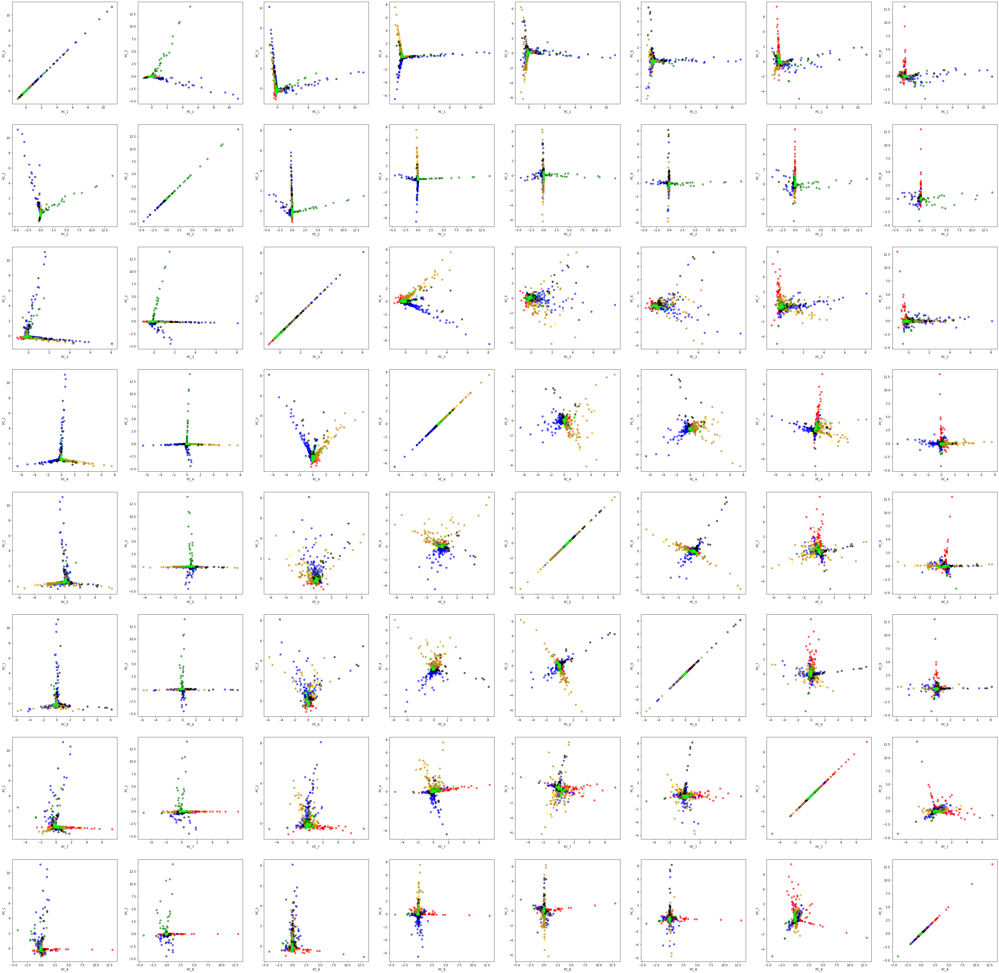

In [44]:
plt.figure(figsize=(60,60))
subplot_num=1

for p in range(len(columnname[:8])):
    for q in range(len(columnname[:8])):
        plt.subplot(8,8,subplot_num)
        for i in range(len(groups)):
            x=pca_withlabel[pca_withlabel['Category']==groups[i]][columnname[p]]
            y=pca_withlabel[pca_withlabel['Category']==groups[i]][columnname[q]]
            plt.scatter(x,y,alpha=0.6,color=colors_list[i],label=groups[i])
            plt.xlabel(columnname[p])
            plt.ylabel(columnname[q])
        subplot_num=subplot_num+1

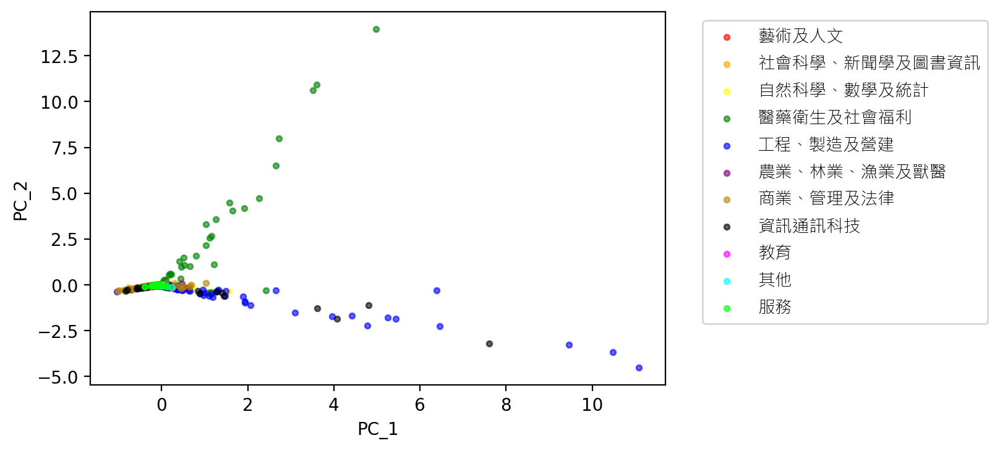

In [45]:
plt.rcParams["figure.dpi"]=200
for i in range(len(groups)):
    x=pca_withlabel[pca_withlabel['Category']==groups[i]]['PC_1']
    y=pca_withlabel[pca_withlabel['Category']==groups[i]]['PC_2']
    plt.scatter(x,y,s=10,alpha=0.6,color=colors_list[i],label=groups[i])
    plt.xlabel('PC_1')
    plt.ylabel('PC_2')

plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

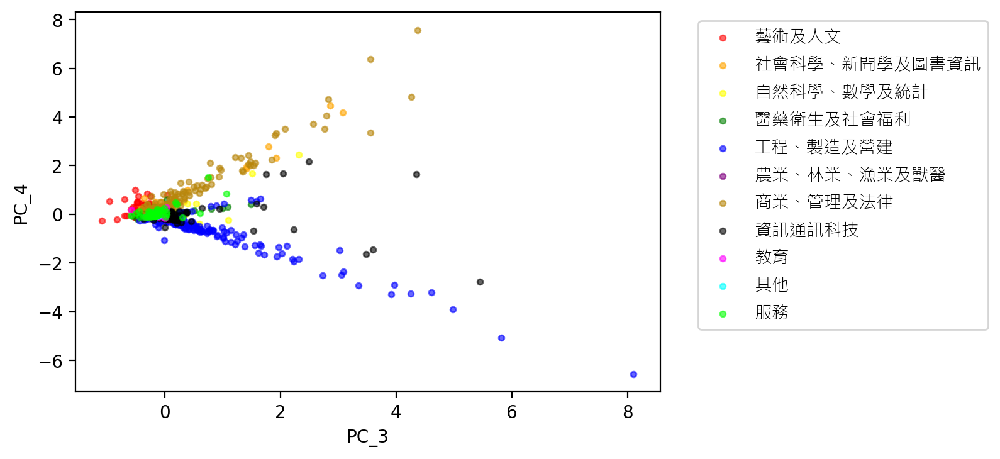

In [46]:
for i in range(len(groups)):
    x=pca_withlabel[pca_withlabel['Category']==groups[i]]['PC_3']
    y=pca_withlabel[pca_withlabel['Category']==groups[i]]['PC_4']
    plt.scatter(x,y,s=10,alpha=0.6,color=colors_list[i],label=groups[i])
    plt.xlabel('PC_3')
    plt.ylabel('PC_4')

plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

2.1 解釋：  
我有針對前八個PC繪製出不同組合的散佈圖，雖然從這幾張輸出的圖來看，好像大多數的點點都擠在一起，沒有辦法看出很明顯的區隔，不過其中我認為PC1和PC2的組合以及PC3以及PC4的組合比較可以看出類別之間的分別，圖表如上輸出所示。  
其中，有蠻多工程製造及營建（藍色）相關的科系會在PC1的值比較大，而也有不少醫藥衛生及社會福利的相關科系（綠色）則是在PC2的值有比較大的傾向。
另外，亦可從PC3和PC4的散佈圖中看出，藝術與人文（紅色）的科系有頗多落在PC3值小於0的位置。至於PC4，可看出商業管理及法律（土黃色）的科系，會有較大的PC4值，而工程製造及營建（藍色）則會有較小的PC4值。

#### Q2.2 (10%)
Visualize academic departments using multiple dimensional scaling. Consider both the metric and non-metric settings. Discuss the result. 

,Coordinate1,Coordinate2,Category
0,-3.556877,4.567446,藝術及人文
1,1.036031,-11.126038,藝術及人文
2,5.04692,-5.763513,藝術及人文
3,5.049937,-0.668421,藝術及人文
4,-2.367645,-1.31535,藝術及人文


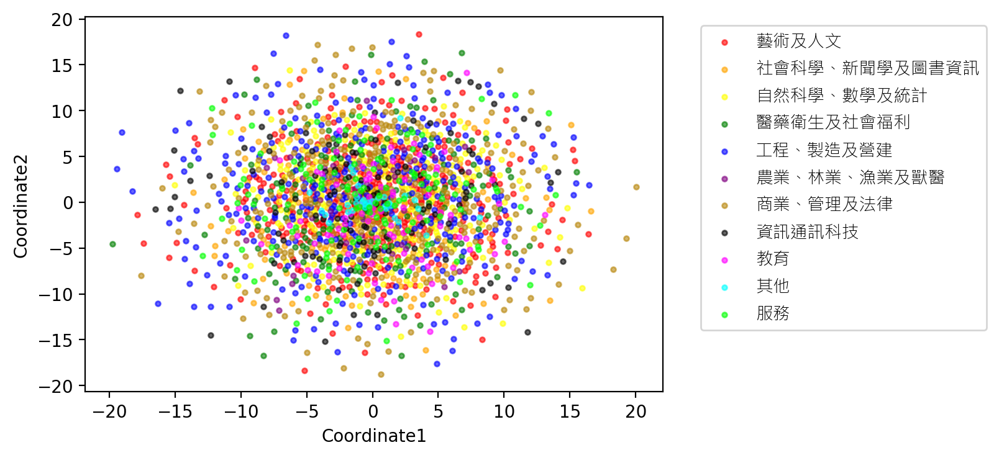

In [47]:
# Q2.2
from sklearn.manifold import MDS

# metric
mds_metric=MDS(n_components=2,metric=True)
mds_outcome_metric=mds_metric.fit_transform(dep_stu2)
drawscatterplot(mds_outcome_metric)

,Coordinate1,Coordinate2,Category
0,0.027125,-0.397006,藝術及人文
1,-0.139433,-0.066766,藝術及人文
2,0.32911,-0.304761,藝術及人文
3,0.230089,0.35844,藝術及人文
4,0.383664,0.211629,藝術及人文


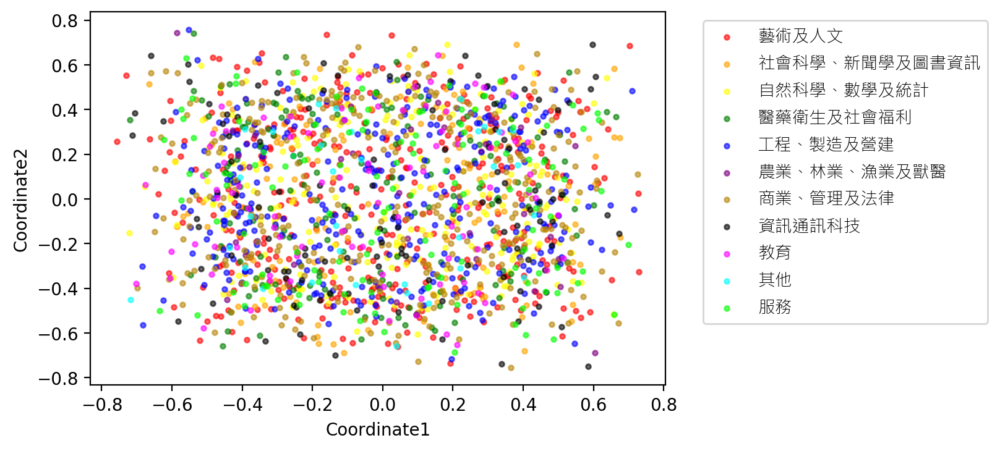

In [48]:
# non-metric
mds_nonmetric=MDS(n_components=2,metric=False)
mds_outcome_nonmetric=mds_nonmetric.fit_transform(dep_stu2)
drawscatterplot(mds_outcome_nonmetric)

2.2 解釋：  
在multiple dimensional scaling這個方法的表現上，很難可以從散佈圖中看出什麼pattern，大部分的資料點都是混雜在一起，但整體可看出non-metric的散佈圖可能比metric的還要來得分散一點，點與點之前的重疊也稍微少一些。但儘管如此，此方法對於這筆資料集、並用這10個類別來區分的情況下，降維效果並不是太理想。

#### Q2.3 (10%)
Visualize academic departments using Locally Linear Embedding. Consider three variations: (1) Use 20 neighbors to construct the weight matrix; (2) Use 40 neighbors to construct the weight matrix; (3) Perform PCA transformation first, and use the first 100 principal components as the input to LLE (with 20 neighbors). Discuss the result. 

,Coordinate1,Coordinate2,Category
0,-0.001034,-0.001104,藝術及人文
1,-0.00099,-0.001292,藝術及人文
2,-0.001037,-0.001112,藝術及人文
3,-0.001034,-0.001104,藝術及人文
4,-0.001026,-0.001063,藝術及人文


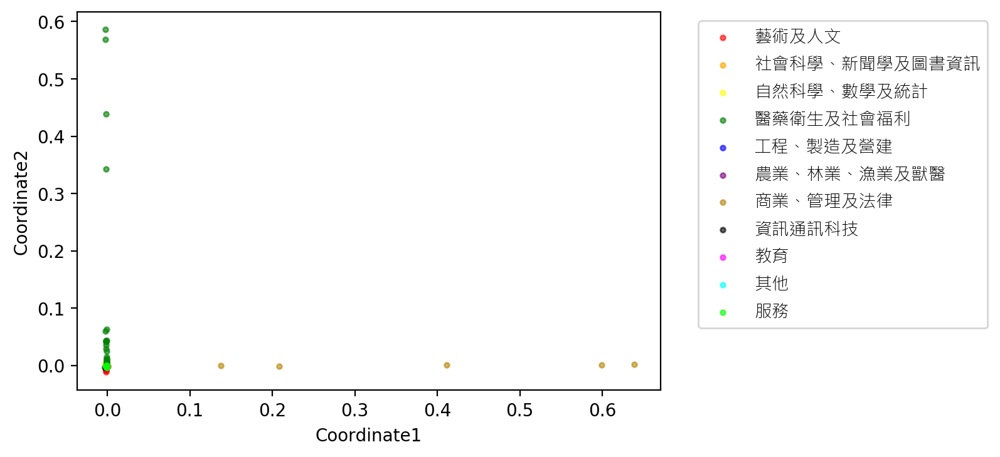

In [49]:
# Q2.3
from sklearn.manifold import LocallyLinearEmbedding

# (1) 20 neighbors
LLE_20=LocallyLinearEmbedding(n_neighbors=20,n_components=2,random_state=0)
LLE_20_outcome=LLE_20.fit_transform(dep_stu2)
drawscatterplot(LLE_20_outcome)

,Coordinate1,Coordinate2,Category
0,-0.001034,-0.001104,藝術及人文
1,-0.00099,-0.001292,藝術及人文
2,-0.001037,-0.001112,藝術及人文
3,-0.001034,-0.001104,藝術及人文
4,-0.001026,-0.001063,藝術及人文


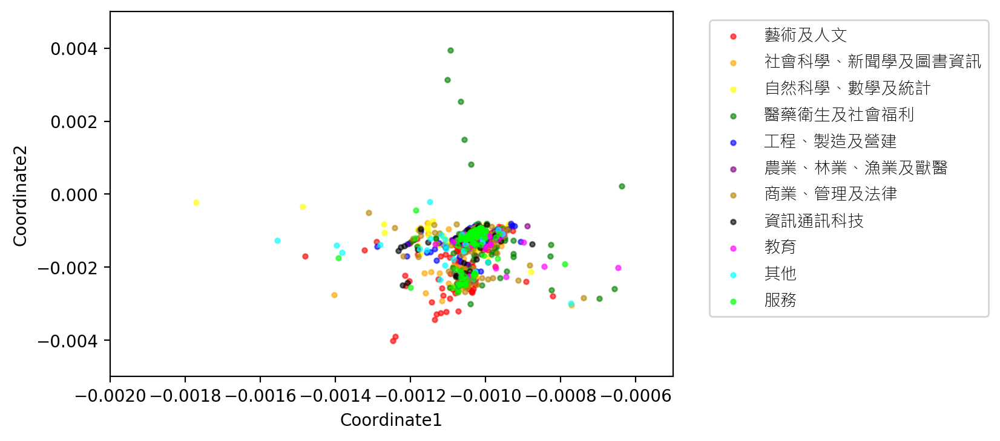

In [50]:
# 20 neighbors closer
df_fitoutcome=LLE_20_outcome

df_withlabel=np.c_[df_fitoutcome,dep_stu_categoryname]
df_withlabel=pd.DataFrame(df_withlabel)
columnname=['Coordinate1','Coordinate2','Category']
df_withlabel.columns=columnname
display(df_withlabel.head(5))
for i in range(len(groups)):        
    x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
    y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
    plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])
plt.xlabel(columnname[0])
plt.ylabel(columnname[1]) 

plt.xlim(-0.002,-0.0005)
plt.ylim(-0.005,0.005)

plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

,Coordinate1,Coordinate2,Category
0,0.001028,-0.001496,藝術及人文
1,-0.000044,-0.001532,藝術及人文
2,0.001022,-0.001434,藝術及人文
3,0.001002,-0.001478,藝術及人文
4,0.000998,-0.001426,藝術及人文


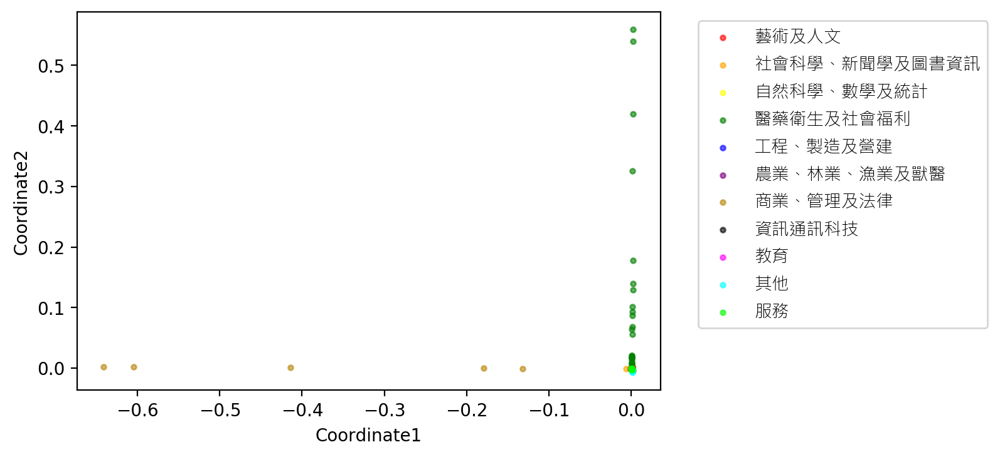

In [51]:
# (2) 40 neighbors
LLE_40=LocallyLinearEmbedding(n_neighbors=40,n_components=2)
LLE_40_outcome=LLE_40.fit_transform(dep_stu2)
drawscatterplot(LLE_40_outcome)

,Coordinate1,Coordinate2,Category
0,0.001028,-0.001496,藝術及人文
1,-0.000044,-0.001532,藝術及人文
2,0.001022,-0.001434,藝術及人文
3,0.001002,-0.001478,藝術及人文
4,0.000998,-0.001426,藝術及人文


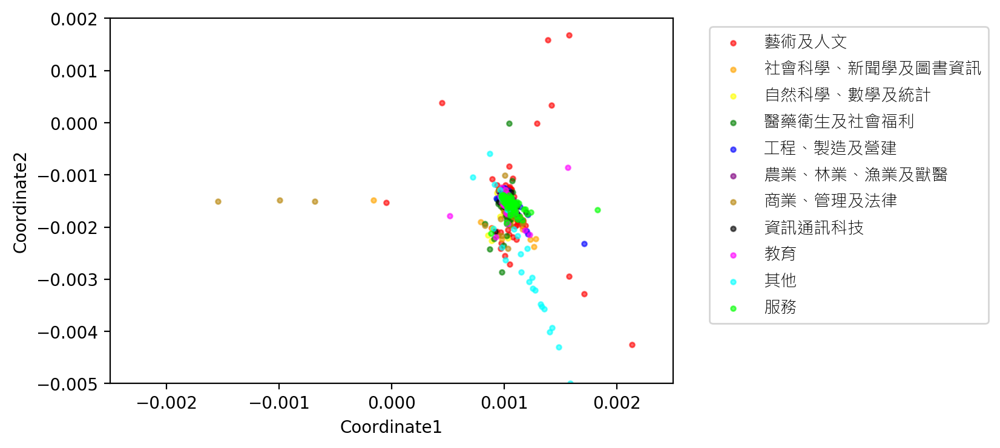

In [52]:
# 40 neighbors closer
df_fitoutcome=LLE_40_outcome

df_withlabel=np.c_[df_fitoutcome,dep_stu_categoryname]
df_withlabel=pd.DataFrame(df_withlabel)
columnname=['Coordinate1','Coordinate2','Category']
df_withlabel.columns=columnname
display(df_withlabel.head(5))
for i in range(len(groups)):        
    x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
    y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
    plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])
plt.xlabel(columnname[0])
plt.ylabel(columnname[1]) 

plt.xlim(-0.0025,0.0025)
plt.ylim(-0.005,0.002)

plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

,Coordinate1,Coordinate2,Category
0,-0.001158,-0.008489,藝術及人文
1,0.005963,-0.017735,藝術及人文
2,-0.00012,-0.009863,藝術及人文
3,-0.001154,-0.006441,藝術及人文
4,-0.001205,-0.006463,藝術及人文


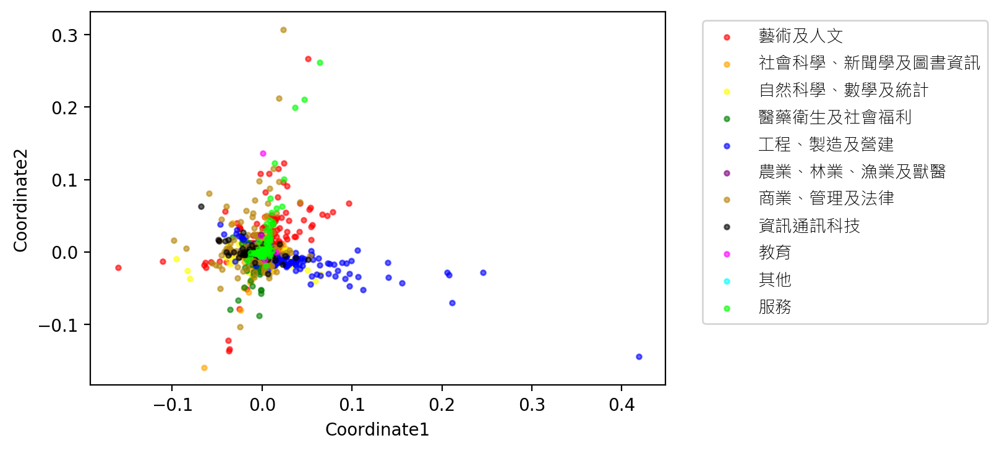

In [53]:
# (3) PCA + 20 neighbors
pca=PCA(n_components=100)
pca.fit(dep_stu2)
pca_outcome=pca.transform(dep_stu2)

LLE_pca20=LocallyLinearEmbedding(n_neighbors=20,n_components=2)
LLE_pca20_outcome=LLE_pca20.fit_transform(pca_outcome)
drawscatterplot(LLE_pca20_outcome)

2.3 解釋：  
從第(1)小題，neighbor=20的散佈圖來看，大多數的資料點都落在Coordiante1與Coordinate2的0到0.1之間。若是有資料點在Coordinate1的值大於0.1，則為商業管理及法律的科系；而若有資料點落在Coordinate2大於0.1的位置，則是醫藥衛生及社會福利的科系。若細部放大，讓Coordinae1介於(-0.002,-0.0005)，Coordinate2介於(-0.005,0.005)，依舊可以看出資料點大部分都擠在一起，並沒有明顯的區隔。

從第(2)小題，neighbor=40的散佈圖來看，如同(1)小題，大多數的資料點都落在Coordiante1的0到-0.1之間與Coordinate2的0到0.1之間。若是有資料點在Coordinate1的值小於-0.1，則為商業管理及法律的科系；而若有資料點落在Coordinate2大於0.1的位置，則是醫藥衛生及社會福利的科系。
若細部放大，讓Coordinae1介於(-0.0025,0.0025)，Coordinate2介於(-0.005,0.002)，儘管「其他」這個類別（亮藍色）可能看似有比較明顯的區隔，但整體類別仍舊是沒有太顯著的區隔。  

從第(3)小題，取前100個PCA且neighbor=20的散佈圖來看，比較沒有都擠在很小的區域的狀況，大部分的資料點也比前兩題的圖分得更開，但整體依舊很難看出區別。可看出LLE在這份資料集、並用這10個類別來區分的情況下，也不是太好的降維方式。

#### Q2.4 (10%)
Visualize academic departments using Kernel PCA. You should at least consider the RBF and Cosine kernel. It is your responsibility to select reasonably good kernel parameters. Discuss the result. 

,Coordinate1,Coordinate2,Category
0,-0.000334,-0.000078,藝術及人文
1,0.001219,-0.000097,藝術及人文
2,-0.000355,-0.000082,藝術及人文
3,-0.000102,-0.000128,藝術及人文
4,-0.000241,-0.000012,藝術及人文


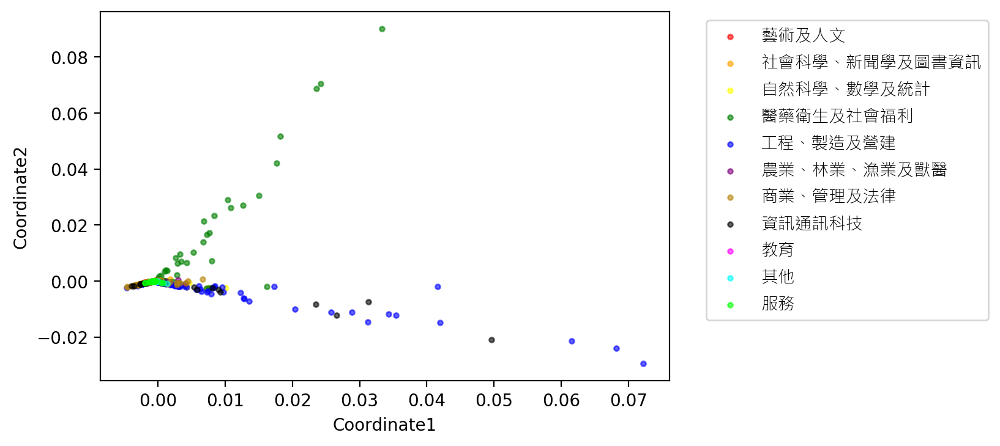

In [54]:
# Q2.4
from sklearn.decomposition import KernelPCA

# RBF
rbf_pca=KernelPCA(n_components=2,kernel='rbf')
rbf_pca_outcome=rbf_pca.fit_transform(dep_stu2)
drawscatterplot(rbf_pca_outcome)

,Coordinate1,Coordinate2,Category
0,0.011949,-0.034091,藝術及人文
1,0.052217,-0.065792,藝術及人文
2,0.013249,-0.03829,藝術及人文
3,0.019058,-0.037534,藝術及人文
4,0.01412,-0.030136,藝術及人文


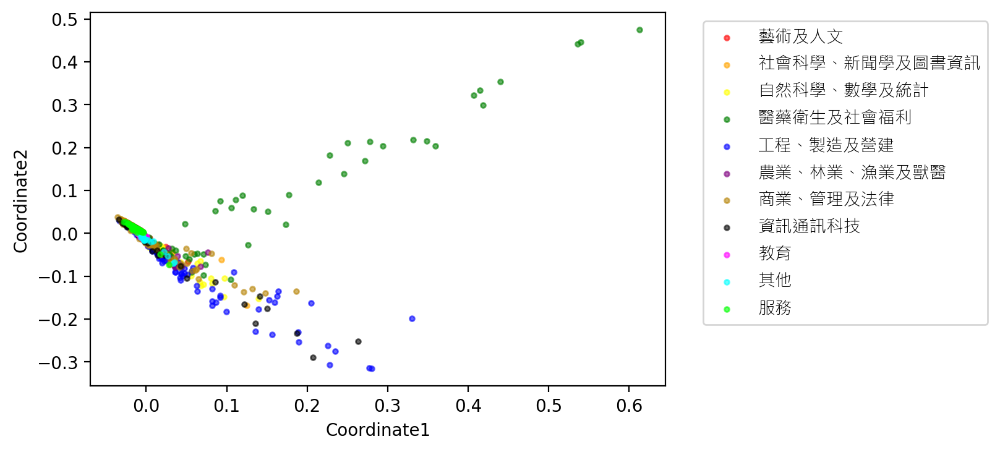

In [55]:
# Cosine
cosine_pca=KernelPCA(n_components=2,kernel='cosine')
cosine_pca_outcome=cosine_pca.fit_transform(dep_stu2)
drawscatterplot(cosine_pca_outcome)

,Coordinate1,Coordinate2,Category
0,-0.000255,-0.000097,藝術及人文
1,0.001554,-0.00011,藝術及人文
2,-0.000299,-0.000101,藝術及人文
3,0.00003,-0.000156,藝術及人文
4,-0.000124,-0.000016,藝術及人文


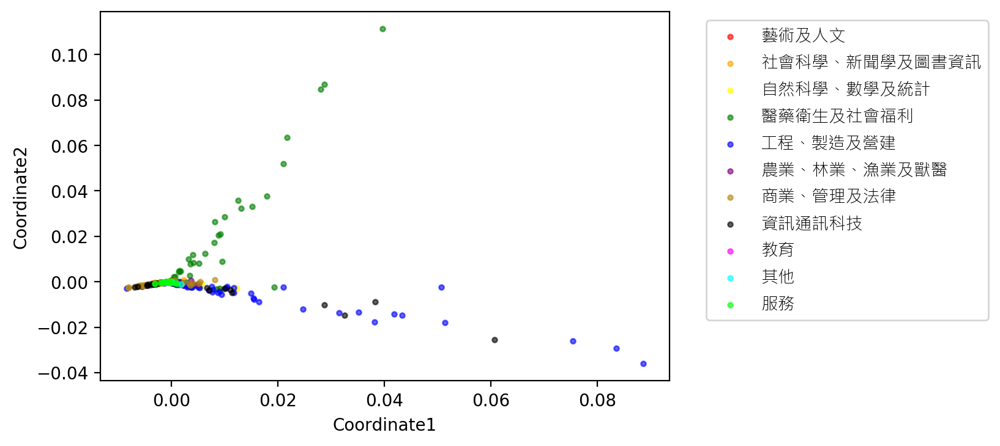

In [56]:
# Poly
poly_pca=KernelPCA(n_components=2,kernel='poly')
poly_pca_outcome=poly_pca.fit_transform(dep_stu2)
drawscatterplot(poly_pca_outcome)

2.4 解釋：  
這題我試了rbf、cosine以及poly三種kernal，僅能看出不管是哪種kernal，醫藥衛生及社會福利（綠色）有部分的科系資料點總是會有比較大的Cordiante1和Coordinate2值，而工程製造及營建這類別也有不少的科系資料點會落在Coordiante1值比較大的位置。  
除此之外，這幾張圖的其他資料點大多擠在一起，看不太出明顯的區隔。

#### Q2.5 (10%)
Visualize academic departments using t-SNE. You should consider at least the Euclidian, Cosine, and Jaccard metric. Set numpy random seed so that your results can be repeated. Discuss the result. 

,Coordinate1,Coordinate2,Category
0,-33.112103,1.91017,藝術及人文
1,-15.453725,4.26617,藝術及人文
2,-14.825746,-25.400833,藝術及人文
3,34.661591,-27.574598,藝術及人文
4,-15.434155,-30.014523,藝術及人文


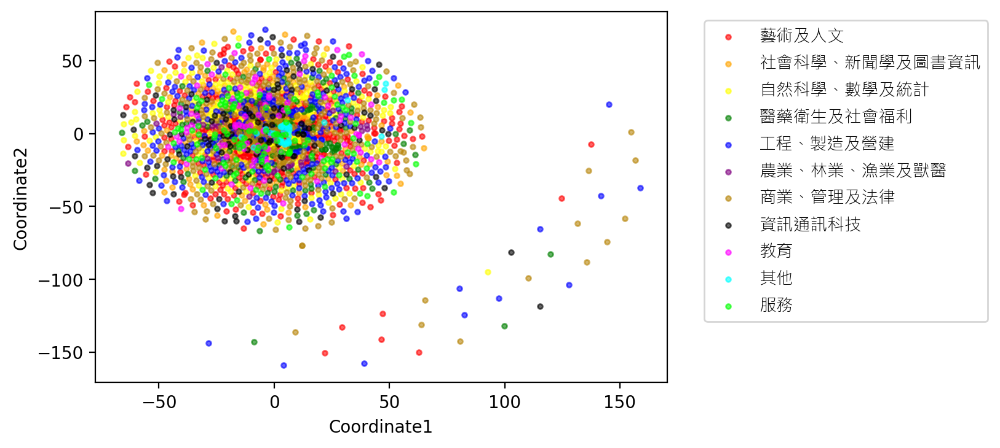

In [57]:
# Q2.5 
from sklearn.manifold import TSNE

# euclidean
tsne_euclidean=TSNE(n_components=2,metric='euclidean',random_state=87)
tsne_euclidean_outcome=tsne_euclidean.fit_transform(dep_stu2)
drawscatterplot(tsne_euclidean_outcome)

,Coordinate1,Coordinate2,Category
0,-52.931911,27.321329,藝術及人文
1,-59.169136,27.566708,藝術及人文
2,-52.02124,28.053099,藝術及人文
3,-51.178371,27.805859,藝術及人文
4,-51.714439,29.44809,藝術及人文


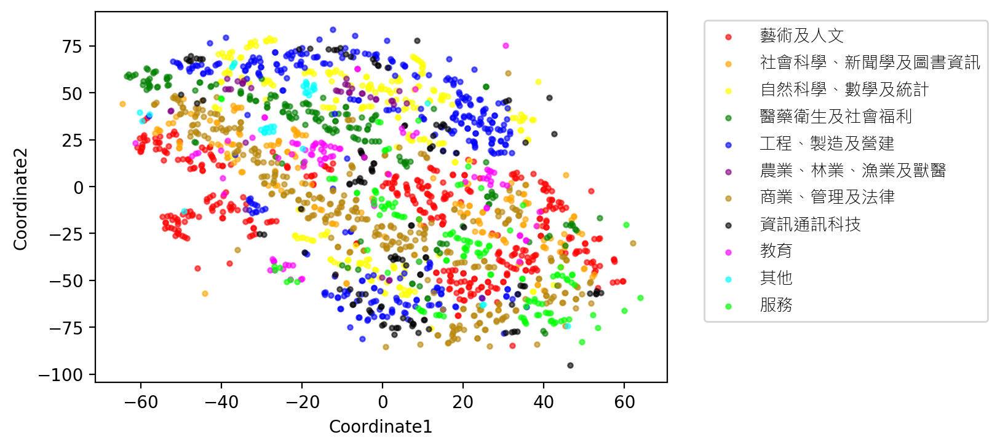

In [58]:
# jaccard
tsne_jaccard=TSNE(n_components=2,metric='jaccard',random_state=87)
tsne_jaccard_outcome=tsne_jaccard.fit_transform(dep_stu2)
drawscatterplot(tsne_jaccard_outcome)

,Coordinate1,Coordinate2,Category
0,-2.964343,-0.940912,藝術及人文
1,66.615211,-44.251076,藝術及人文
2,-4.846578,-0.844037,藝術及人文
3,-0.4616,0.423745,藝術及人文
4,-1.643332,-0.081229,藝術及人文


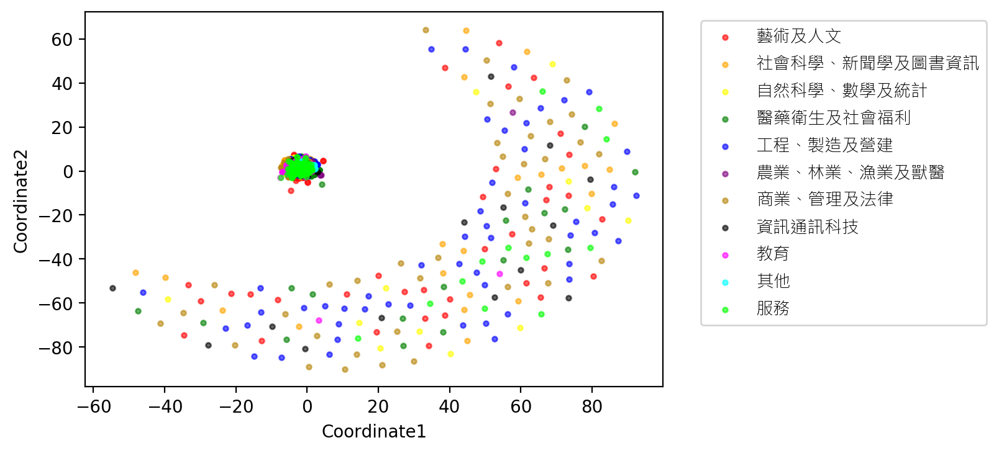

In [59]:
# minkowski
tsne_minkowski=TSNE(n_components=2,metric='minkowski',random_state=87)
tsne_minkowski_outcome=tsne_minkowski.fit_transform(dep_stu2)
drawscatterplot(tsne_minkowski_outcome)

,Coordinate1,Coordinate2,Category
0,39.390579,-41.212086,藝術及人文
1,37.903656,-46.968521,藝術及人文
2,40.38261,-40.463242,藝術及人文
3,40.276592,-39.660492,藝術及人文
4,41.877327,-40.156761,藝術及人文


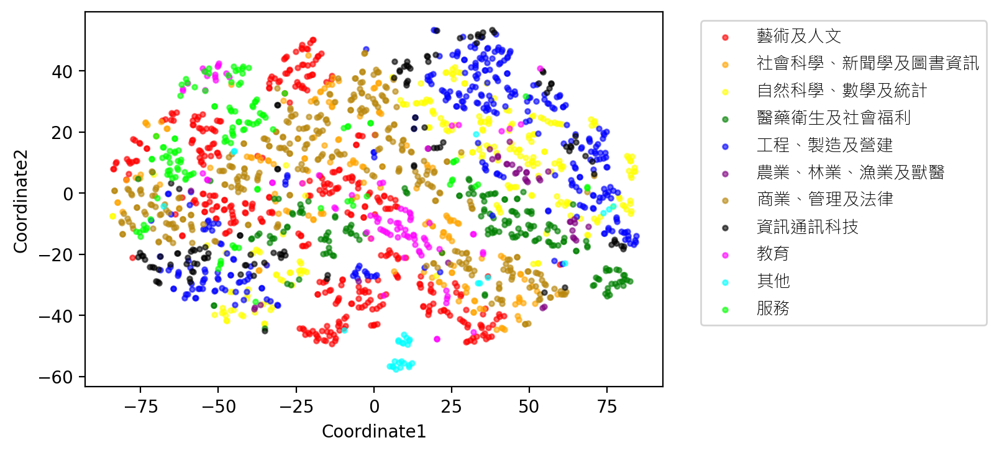

In [60]:
# cosine
tsne_cosine=TSNE(n_components=2,metric='cosine',random_state=87)
tsne_cosine_outcome=tsne_cosine.fit_transform(dep_stu2)
drawscatterplot(tsne_cosine_outcome)

,Coordinate1,Coordinate2,Category
0,39.390579,-41.212086,藝術及人文
1,37.903656,-46.968521,藝術及人文
2,40.38261,-40.463242,藝術及人文
3,40.276592,-39.660492,藝術及人文
4,41.877327,-40.156761,藝術及人文


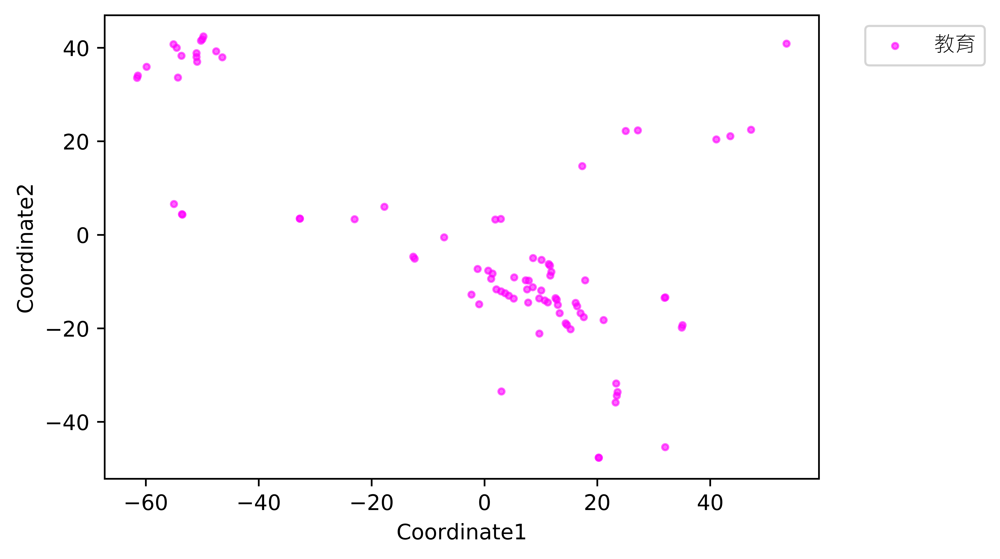

In [61]:
# tsne cosine only pink class
df_fitoutcome=tsne_cosine_outcome

df_withlabel=np.c_[df_fitoutcome,dep_stu_categoryname]
df_withlabel=pd.DataFrame(df_withlabel)
columnname=['Coordinate1','Coordinate2','Category']
df_withlabel.columns=columnname
display(df_withlabel.head(5))

plt.rcParams["figure.dpi"]=1000
i=8
x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])

my_font=font_manager.FontProperties(fname="msjhl.ttc",size=10)
plt.xlabel(columnname[0])
plt.ylabel(columnname[1]) 
plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

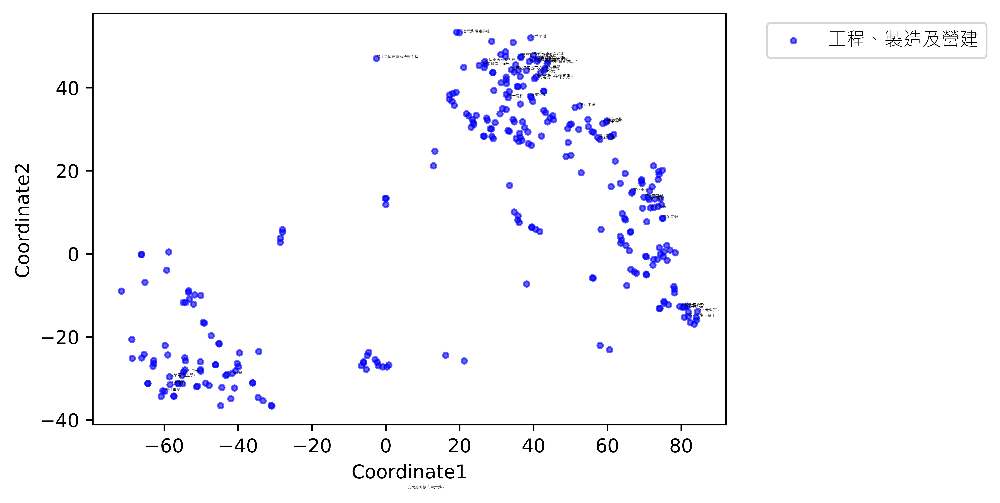

In [62]:
# tsne cosine only blue class
plt.rcParams["figure.dpi"]=1000

i=4
x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])

my_font=font_manager.FontProperties(fname="msjhl.ttc",size=2)    
for i in range(df_withlabel.shape[0]):
    if '電機' in dep_stu_depname[i]:
        plt.text(x=df_withlabel.Coordinate1[i]+0.1,y=df_withlabel.Coordinate2[i]+0.1,s=dep_stu_depname[i], color='black',fontproperties=my_font)

my_font=font_manager.FontProperties(fname="msjhl.ttc",size=10)
plt.xlabel(columnname[0])
plt.ylabel(columnname[1]) 
plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

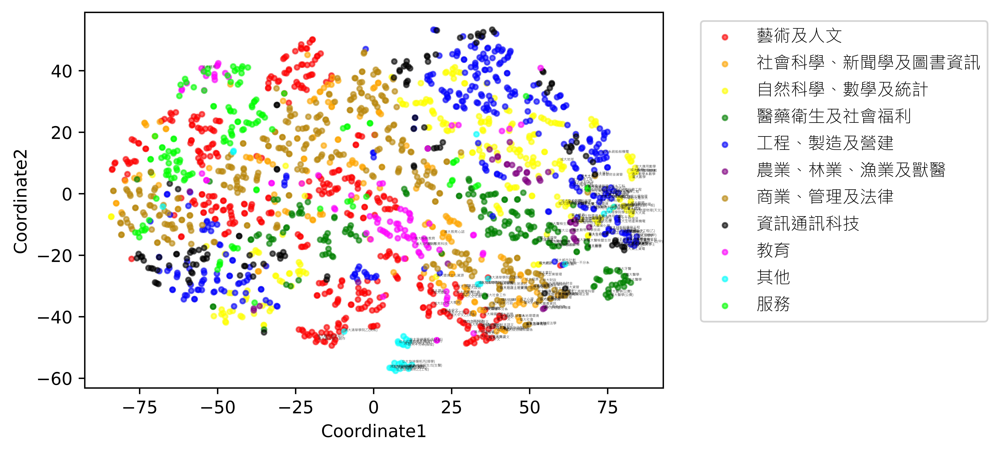

In [63]:
# tsne cosine five school label
plt.rcParams["figure.dpi"]=1000
for i in range(len(groups)):        
    x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
    y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
    plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])

my_font=font_manager.FontProperties(fname="msjhl.ttc",size=2)    
for i in range(df_withlabel.shape[0]):
    if '臺大' in dep_stu_depname[i] or '清大' in dep_stu_depname[i] or '交大' in dep_stu_depname[i] or '成大' in dep_stu_depname[i] or '政大' in dep_stu_depname[i]:
        plt.text(x=df_withlabel.Coordinate1[i]+0.1,y=df_withlabel.Coordinate2[i]+0.1,s=dep_stu_depname[i], color='black',fontproperties=my_font)

my_font=font_manager.FontProperties(fname="msjhl.ttc",size=10)
plt.xlabel(columnname[0])
plt.ylabel(columnname[1]) 
plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')

2.5 解釋：  
這題我試了euclidean、jaccard、minkowski與cosine四種metric。euclidean和minkowski的表現並不是太理想，很多資料點都擠在一起。  
不過，jaccard、cosine的散佈圖則似乎隱約可看出不同顏色的點會一小群一小群的聚在一起，因此我針對metric設為cosine的T-SNE繪製更多圖片來觀察。舉例來說，若是僅單獨繪製「教育」這個類別的資料點，可以看出來大多數的資料點會大概分在兩群。分別是落在Coordinate1的0至-20與Coordinate2的0至(-20)之間一群；以及在Coordinate1的-60至-40與Coordinate2的30至40之間另一群。而若單獨繪製「工程、製造及營建」這個類別，則可以看出資料點大概會落在整張圖的右上和左下。由這種一小群一小群聚在一起的情況來看，這十個類別之中應該還有更細緻的次類別，例如物理系和化學系雖然都是「自然科學、數學及統計」這個大類別，但物理系自己會聚在一起，化學系會另外聚在一起，這兩小群也許在散佈圖上會在不同的位置。　　　　  
另外，若是要再進一步探討，針對台清交成政五間學校的科系標註科系名稱至散佈圖中，可發現這幾間學校的科系的資料點大多都落在整張散佈圖的右下角，由此可知，或許（僅是針對散佈圖與標籤做粗略推論）使用學校作為顏色類別來繪製散佈圖，也可以看出一些明顯的區隔。

#### Q2.6 (10%) 
Select the most promising visualization method in the previous question and refine the result. You should color points by department category. Label each data point with its name so that we can quickly identify a data point on the picture. Moreover, you should try to reduce the problem caused by overlapping points and labels. Output an image that is large enough so that a user can easily identify a department and its neighbors. Jupyter Lab has limitations on the largest picture size. To overcome this problem, output the picture to a separate file and submit the file for grading. Your score depends on how useful, readable, and visually pleasing of your visualization results. 

,Coordinate1,Coordinate2,Category
0,39.390579,-41.212086,藝術及人文
1,37.903656,-46.968521,藝術及人文
2,40.38261,-40.463242,藝術及人文
3,40.276592,-39.660492,藝術及人文
4,41.877327,-40.156761,藝術及人文


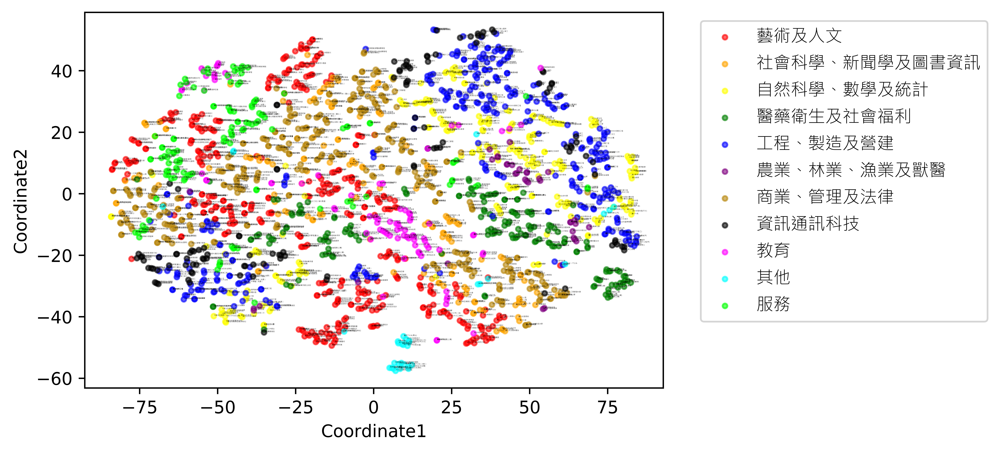

In [64]:
# Q2.6
from sklearn.manifold import TSNE

plt.rcParams["figure.dpi"]=1000
tsne_cosine=TSNE(n_components=2,metric='cosine',random_state=87)
tsne_cosine_outcome=tsne_cosine.fit_transform(dep_stu2)
df_fitoutcome=tsne_cosine_outcome
df_withlabel=np.c_[df_fitoutcome,dep_stu_categoryname]
df_withlabel=pd.DataFrame(df_withlabel)
columnname=['Coordinate1','Coordinate2','Category']
df_withlabel.columns=columnname
display(df_withlabel.head(5))

my_font=font_manager.FontProperties(fname="msjhl.ttc",size=0.5)    
for i in range(len(groups)):        
    x=df_withlabel[df_withlabel['Category']==groups[i]][columnname[0]]
    y=df_withlabel[df_withlabel['Category']==groups[i]][columnname[1]]
    plt.scatter(x,y,s=8,alpha=0.6,color=colors_list[i],label=groups[i])


for i in range(df_withlabel.shape[0]):
    plt.text(x=df_withlabel.Coordinate1[i]+0.1,y=df_withlabel.Coordinate2[i]+0.1,s=dep_stu_depname[i], 
             color='black',fontproperties=my_font)
    
my_font=font_manager.FontProperties(fname="msjhl.ttc",size=10)
plt.xlabel(columnname[0])
plt.ylabel(columnname[1]) 
plt.legend(prop=my_font,bbox_to_anchor=(1.05, 1.0),loc='upper left')


2.6 解釋：  
我針對TSNE、metric為cosine的降維方法來繪製含有資料標籤（也就是學校科系名稱）的散佈圖，可見附檔tsne_cosine_all.png檔案。